1. Cargue el audio provisto y escuche la version original

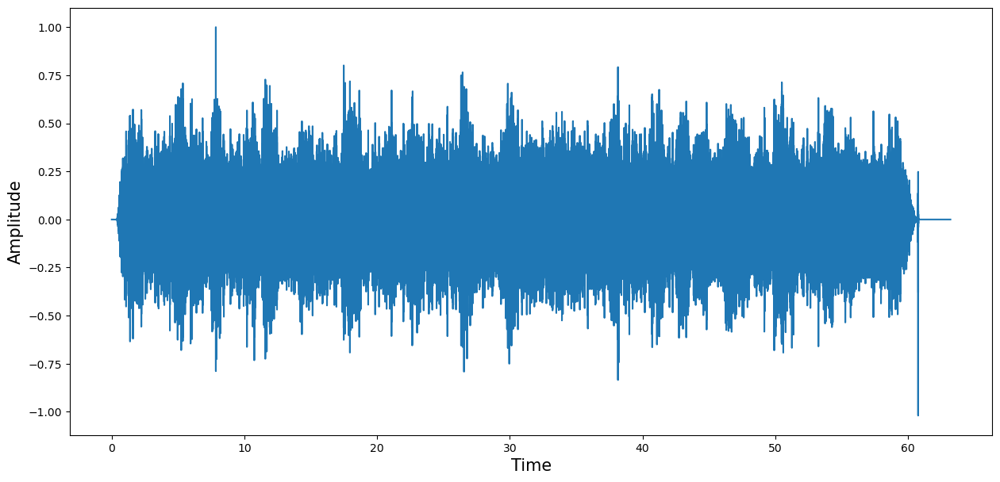

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import Audio 
from scipy.io.wavfile import read  #libreria para la lectura de audios


file_audio=('test2.wav') #Ruta del archivo con la señal
fs, x=read(file_audio)  #Cargar el archivo
x=x/float(max(x))  #Escala de amplitud de la señal
x=x-np.mean(x)


t=np.arange(0,float(len(x))/fs, 1/fs)  #vector de tiempo
plt.figure(figsize=(15,7))
plt.plot(t,x)  
plt.xlabel('Time',fontsize=15)
plt.ylabel('Amplitude',fontsize=15)
plt.show()
Audio(x,rate=fs)


In [2]:
#---------------------------------Codigo Necesario por si el audio cargado es estereo------------------------
import soundfile as sf

# Ruta del archivo de audio estéreo
archivo_estereo = '10466.wav'

# Ruta de destino para el archivo de audio mono
archivo_mono = 'test2.wav'

# Cargar el archivo de audio estéreo
data, samplerate = sf.read(archivo_estereo)

# Extraer una sola columna (canal) del archivo de audio estéreo
data_mono = data[:, 0]  # Seleccionar el primer canal (izquierdo)

# Escribir el archivo de audio mono
sf.write(archivo_mono, data_mono, samplerate)

2. Grafique el espectro del audio y explique, ¿Desde el espectro se pueden apreciar las frecuencias de cada especie mencionada en la guia?

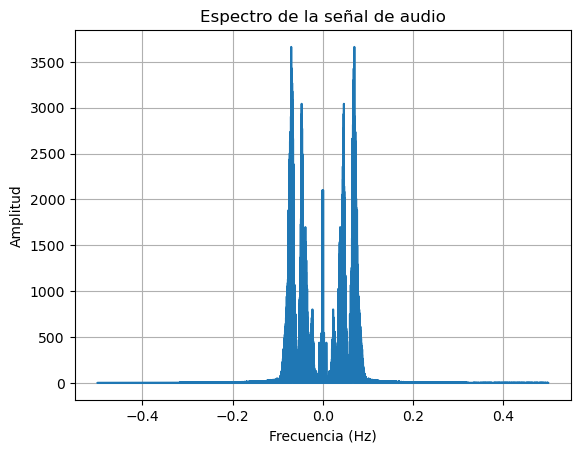

In [3]:
import numpy as np
import matplotlib.pyplot as plt

# Cargar la señal de audio
audio = x  # Datos de audio (por ejemplo, de un archivo WAV)

# Calcular la transformada de Fourier de la señal de audio
fft = np.fft.fft(audio)

# Calcular las amplitudes de las frecuencias
amplitudes = np.abs(fft)

# Crear el vector de frecuencias correspondiente
frecuencias = np.fft.fftfreq(len(audio))

# Graficar el espectro de amplitud
plt.plot(frecuencias, amplitudes)
plt.xlabel('Frecuencia (Hz)')
plt.ylabel('Amplitud')
plt.title('Espectro de la señal de audio')
plt.grid(True)
plt.show()

R/: Si, desde el espectro se pueden notar 3 picos aparte del central, que es el nivel DC de la señal, cada pico representa la frecuencia fundamental de cada especie, con los 2 primeros estando muy cerca, con esto es posible decir que aplicando un filtro pasa-banda se puede extraer el sonido de cada especie

3.0 Diseño de Filtro para extraer 2 audios, el primer filtro sera para obtener el sonido de los grillos, consulte en internet el rango de frecuencia que producen los grillos y en base a eso realice la parametrizacion de un filtro pasa-banda

R/:El sonido de los grillos, conocido como "canto de los grillos", generalmente se encuentra en el rango de frecuencias de 2 kHz a 8 kHz. Estas frecuencias corresponden a tonos agudos y se caracterizan por su tonalidad chirriante y estridente. Sin embargo, es importante tener en cuenta que el rango de frecuencia del sonido de los grillos puede variar dependiendo de la especie de grillo y otros factores. Algunas especies de grillos pueden producir sonidos en un rango de frecuencias más amplio, mientras que otras pueden tener un rango más estrecho. Además, la intensidad y el patrón del sonido de los grillos también pueden variar según la especie y las condiciones ambientales.

3.1 diseñe el filtro pasa-banda y apliquele una ventana que usted considere (No se evaluara cual ventana es la correcta, asuma que tiene recursos suficientes para usar cualquier ventana), luego grafique la respuesta de ese filtro con y sin ventana

3.2 aplique el filtro al audio original y grafique en sub-plots cada resultado, escuche el resultado obtenido y responda, ¿Se logra separar el canto de los grillos? y si no, ¿Por que? (Nota: el estudiante usando parametros correctos debe ser capaz de obtener un resultado sastifactorio)

R/: Si se logra separar el canto de manera correcta, aunque aun se perciben cantos de ranas y sapos atenuados, se debe a la proximidad entre cantos de cada especie

3.3 Grafique nuevamente el espectro del resultado anterior, responda: ¿El resultado es el esperado segun su respuesta en el numeral #2?

R/: si se logra separar el pico extremo del espectro original, el de frecuencia mas alta osea los sonidos mas agudos que corresponden a los grillos.



In [4]:
import numpy as np
from matplotlib.pylab import *
#from scipy import *
import scipy.signal as signal
#from ztrans import *


def choose_windows(name='Hamming', N=20):
    # Rect/Hanning/Hamming
    if name == 'Hamming':
        window = np.array([0.54 - 0.46 * np.cos(2 * np.pi * n / (N - 1)) for n in range(N)])
    elif name == 'Hanning':
        window = np.array([0.5 - 0.5 * np.cos(2 * np.pi * n / (N - 1)) for n in range(N)])
    elif name == 'Rect':
        window = np.ones(N)
    elif name == 'black':
        window = np.array([0.42-0.5*np.cos((2*np.pi*n)/(N-1))+0.08*np.cos((4*np.pi*n)/(N-1))for n in range(N)])
    return window



In [5]:
fc1=2500.0
fc2=8000.0
#fs=16000.0 # frec de muestreo
Adb=0 # Ganancia del filtro en decibeles
N = 512 # Numero de puntos de la FFT
BW=200 # Ancho de banda en la banda de transicion

wc1 = 2*np.pi*fc1/fs # frecuencia de corte normalizada en radianes
wc2= 2*np.pi*fc2/fs

bwn=2*np.pi*BW/fs # ancho de banda  normalizado en radianes

M=int(4/bwn) # orden estimado del filtro
print('Orden del filtro: ', M)

n = np.arange(-M,M)


Orden del filtro:  140


In [6]:
h1 = ((wc2)/np.pi) * np.sinc((wc2*n)/np.pi)-((wc1)/np.pi)* np.sinc((wc1*n)/np.pi) # Respuesta del filtro ideal 

h1[n==0]=(wc2-wc1)/np.pi # cuando es pasabanda

w1,Hh1 = signal.freqz(h1,1,whole=True, worN=N) # Respuesta en frecuencia del filtro ideal

win2 = choose_windows(name='Hamming', N=len(n))

h2=h1*win2 # Multiplico la respuesta ideal por la ventana

A=np.sqrt(10**(0.1*Adb))
h2=h2*A # Ganancia del filtro
w2,Hh2 = signal.freqz(h2,1,whole=True, worN=N) # Respuesta en frecuencia del filtro enventanado

Text(0, 0.5, '$|H2(\\omega)| $')

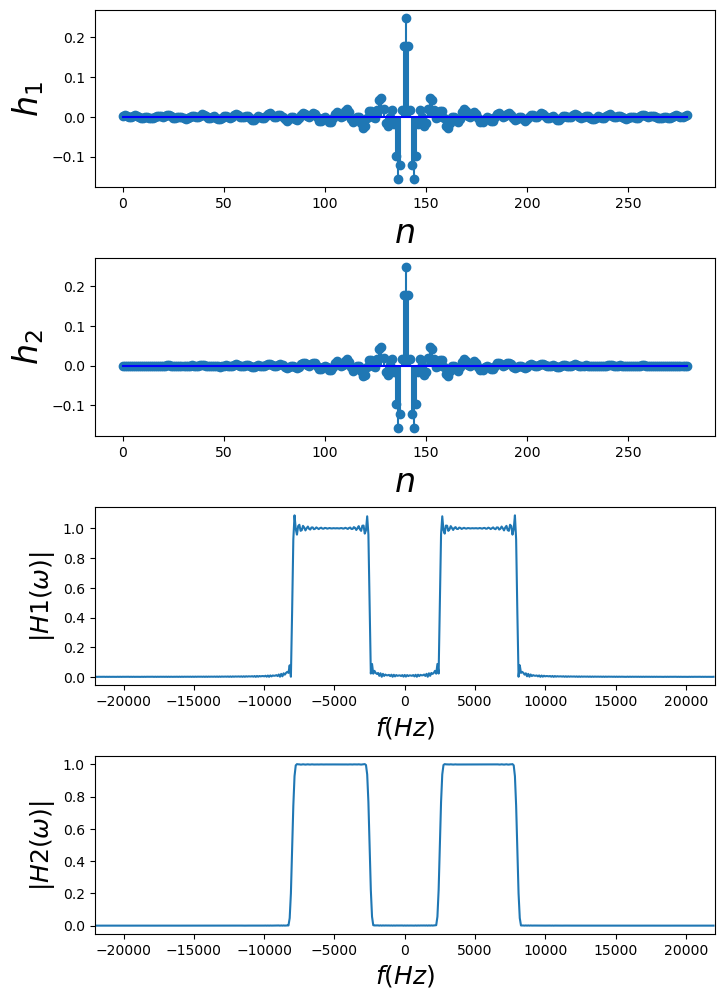

In [7]:
fig1,axs1 = subplots(4,1)
fig1.set_size_inches((8,12))
subplots_adjust(hspace=0.4)

ax=axs1[0]
#ax.axis(xmax=2000, xmin=-2000)  # Límite en el eje x
ax.stem(n+M,h1,basefmt='b-')
ax.set_xlabel("$n$",fontsize=24)
ax.set_ylabel("$h_1$",fontsize=24)


ax=axs1[1]
#ax.axis(xmax=2000, xmin=-2000)  # Límite en el eje x
ax.stem(n+M,h2,basefmt='b-')
ax.set_xlabel("$n$",fontsize=24)
ax.set_ylabel("$h_2$",fontsize=24)



ax=axs1[2]
ax.plot((w1-np.pi)*fs/(2*np.pi),np.abs(np.fft.fftshift(Hh1)))
ax.axis(xmax=fs/2,xmin=-fs/2)
#ax.axis(xmax=2000, xmin=-2000)  # Límite en el eje x
#ax.vlines([-fc,fc],0,1,color='g',lw=2.,linestyle='--')
#ax.hlines(1,-fc,fc,color='g',lw=2.,linestyle='--')
ax.set_xlabel(r"$f (Hz)$",fontsize=18)
ax.set_ylabel(r"$|H1(\omega)| $",fontsize=18)

ax=axs1[3]
ax.plot((w2-np.pi)*fs/(2*np.pi),np.abs(np.fft.fftshift(Hh2)))
ax.axis(xmax=fs/2,xmin=-fs/2)
#ax.axis(xmax=2000, xmin=-2000)  # Límite en el eje x
#ax.vlines([-fc,fc],0,1,color='g',lw=2.,linestyle='--')
#ax.hlines(1,-fc,fc,color='g',lw=2.,linestyle='--')
ax.set_xlabel(r"$f (Hz)$",fontsize=18)
ax.set_ylabel(r"$|H2(\omega)| $",fontsize=18)




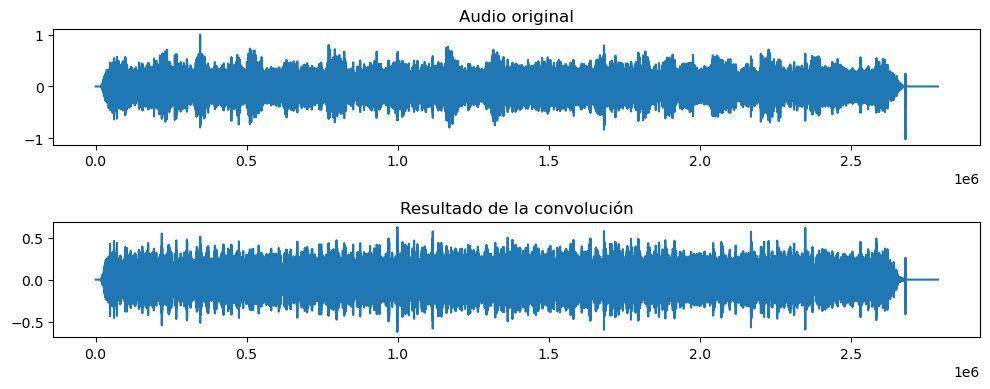

In [8]:
# Realizar la convolución
resultado = signal.convolve(x, h2, mode='same')
plt.figure(figsize=(10, 4))
plt.subplot(2, 1, 1)
plt.plot(audio)
plt.title('Audio original')
plt.subplot(2, 1, 2)
plt.plot(resultado)
plt.title('Resultado de la convolución')
plt.tight_layout()
plt.show()
Audio(x,rate=fs)
Audio(resultado,rate=fs)


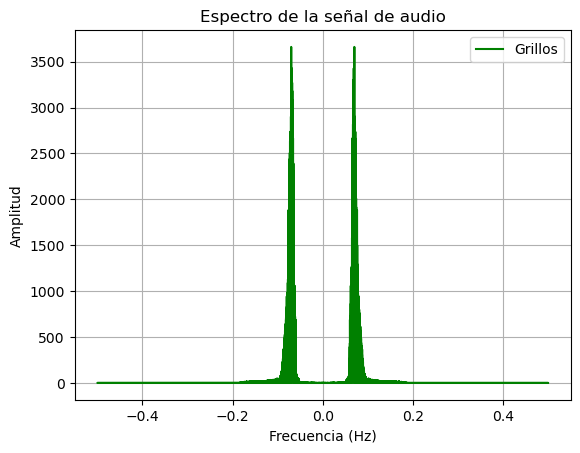

In [9]:
# Cargar la señal de audio
audio = resultado  # Datos de audio (por ejemplo, de un archivo WAV)
audio2=audio
# Calcular la transformada de Fourier de la señal de audio
fft = np.fft.fft(audio)

# Calcular las amplitudes de las frecuencias
amplitudes = np.abs(fft)

# Crear el vector de frecuencias correspondiente
frecuencias = np.fft.fftfreq(len(audio))


# Graficar el espectro de amplitud
plt.plot(frecuencias, amplitudes, color='green', label='Grillos')

plt.xlabel('Frecuencia (Hz)')
plt.ylabel('Amplitud')
plt.title('Espectro de la señal de audio')
plt.grid(True)
plt.legend()
plt.show()

4. Repita el punto 3 para separar el canto de las ranas y los sapos, consulte en internet el rango de frecuencias, y finalmente grafique en un mismo plot el espectro obtenido por los 2 filtros, utilice colores para identificar correctamente cada canto.

R/: El rango de frecuencia del sonido de las ranas y sapos puede variar considerablemente entre diferentes especies. Sin embargo, en general, el sonido de las ranas y sapos se encuentra en el rango de frecuencias de los sonidos de baja a media frecuencia.

Algunas especies de ranas y sapos emiten llamadas de baja frecuencia, en el rango de 100 Hz a 500 Hz. Estas llamadas suelen ser profundas y resonantes. Por otro lado, muchas especies de ranas y sapos emiten llamadas de frecuencias más altas, generalmente en el rango de 500 Hz a 5 kHz. Estas llamadas pueden ser más agudas y estridentes.

Es importante tener en cuenta que hay una gran diversidad de especies de ranas y sapos en todo el mundo, y cada una tiene su propio rango de frecuencia de llamada característico. Además, las llamadas de las ranas y sapos pueden variar según el sexo, la edad y el propósito de la comunicación, como la atracción de pareja, la defensa territorial o la advertencia de depredadores.

Por lo tanto, el rango de frecuencia del sonido de las ranas y sapos puede abarcar desde frecuencias bajas hasta medias, pero es importante considerar las particularidades de cada especie para obtener información más precisa sobre su rango de frecuencia específico.

Orden del filtro:  140


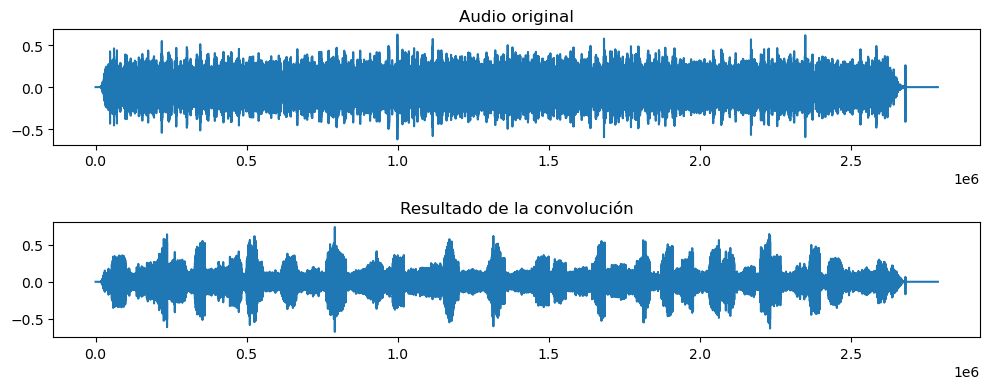

In [10]:
fc1=100.0
fc2=2500.0
#fs=16000.0 # frec de muestreo
Adb=0 # Ganancia del filtro en decibeles
N = 512 # Numero de puntos de la FFT
BW=200 # Ancho de banda en la banda de transicion

wc1 = 2*np.pi*fc1/fs # frecuencia de corte normalizada en radianes
wc2= 2*np.pi*fc2/fs

bwn=2*np.pi*BW/fs # ancho de banda  normalizado en radianes

M=int(4/bwn) # orden estimado del filtro
print('Orden del filtro: ', M)

n = np.arange(-M,M)

h1 = ((wc2)/np.pi) * np.sinc((wc2*n)/np.pi)-((wc1)/np.pi)* np.sinc((wc1*n)/np.pi) # Respuesta del filtro ideal 

h1[n==0]=(wc2-wc1)/np.pi # cuando es pasabanda

w1,Hh1 = signal.freqz(h1,1,whole=True, worN=N) # Respuesta en frecuencia del filtro ideal

win2 = choose_windows(name='black', N=len(n))

h2=h1*win2 # Multiplico la respuesta ideal por la ventana

# Realizar la convolución
resultado = signal.convolve(x, h2, mode='same')
plt.figure(figsize=(10, 4))
plt.subplot(2, 1, 1)
plt.plot(audio)
plt.title('Audio original')
plt.subplot(2, 1, 2)
plt.plot(resultado)
plt.title('Resultado de la convolución')
plt.tight_layout()
plt.show()

Audio(resultado,rate=fs)

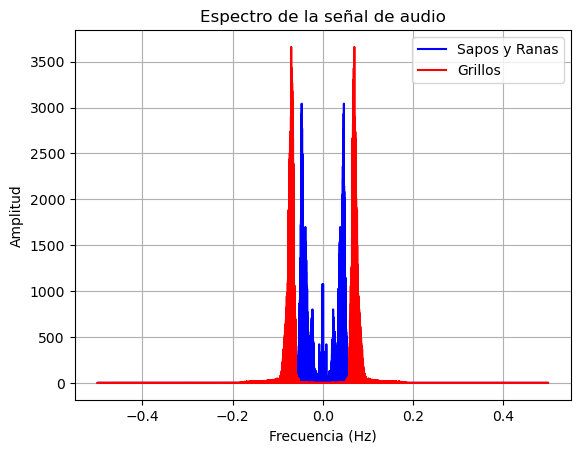

In [11]:
# Cargar la señal de audio
audio = resultado  # Datos de audio (por ejemplo, de un archivo WAV)

# Calcular la transformada de Fourier de la señal de audio
fft = np.fft.fft(audio)
fft2 = np.fft.fft(audio2)
# Calcular las amplitudes de las frecuencias
amplitudes = np.abs(fft)
amplitudes2 = np.abs(fft2)
# Crear el vector de frecuencias correspondiente
frecuencias = np.fft.fftfreq(len(audio))
frecuencias2 = np.fft.fftfreq(len(audio2))

# Graficar el espectro de amplitud
plt.plot(frecuencias, amplitudes, color='blue', label='Sapos y Ranas')
plt.plot(frecuencias2, amplitudes2, color='red', label='Grillos')
plt.xlabel('Frecuencia (Hz)')
plt.ylabel('Amplitud')
plt.title('Espectro de la señal de audio')
plt.grid(True)
plt.legend()
plt.show()

5. Realice una consulta sobre la ventana de Kaiser, sus aplicaciones y si es viable para la extraccion de cantos en animales, realice un codigo que varie el parametro Beta en los valores "[1, 5, 20, 150, 350]", explique que cambia con la variacion de este parametro.

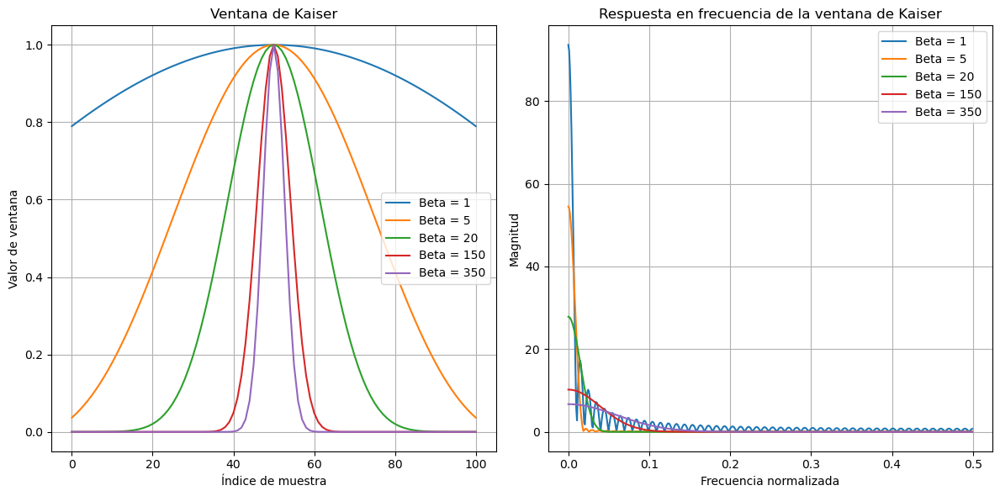

In [20]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import windows, freqz

# Parámetros de la ventana de Kaiser
window_length = 101  # Longitud de la ventana
beta_values = [1, 5, 20, 150, 350]  # Valores de beta

# Graficar la ventana de Kaiser y la respuesta en frecuencia para cada valor de beta
plt.figure(figsize=(12, 6))

# Graficar la ventana de Kaiser
plt.subplot(1, 2, 1)
for beta in beta_values:
    window = windows.kaiser(window_length, beta)
    plt.plot(window, label=f'Beta = {beta}')

plt.title('Ventana de Kaiser')
plt.xlabel('Índice de muestra')
plt.ylabel('Valor de ventana')
plt.grid(True)
plt.legend()

# Graficar la respuesta en frecuencia
plt.subplot(1, 2, 2)
for beta in beta_values:
    window = windows.kaiser(window_length, beta)
    w, h = freqz(window)
    frequencies = w / (2 * np.pi)
    amplitude = np.abs(h)
    plt.plot(frequencies, amplitude, label=f'Beta = {beta}')

plt.title('Respuesta en frecuencia de la ventana de Kaiser')
plt.xlabel('Frecuencia normalizada')
plt.ylabel('Magnitud')
plt.grid(True)
plt.legend()

plt.tight_layout()
plt.show()

R/: En el caso de filtrar sonidos de sapos y grillos, una ventana comúnmente utilizada es la ventana de Kaiser. La ventana de Kaiser es una ventana paramétrica que permite ajustar la relación entre la atenuación de los lóbulos laterales y la resolución en frecuencia.

La ventana de Kaiser es útil cuando se requiere un control preciso sobre la atenuación espectral y la resolución en frecuencia. Al ajustar el parámetro de la ventana, puedes lograr un equilibrio adecuado para eliminar el ruido no deseado y preservar las características importantes de los sonidos de sapos y grillos.

Es importante tener en cuenta que el diseño de un filtro para extraer específicamente los sonidos de sapos y grillos puede requerir técnicas más avanzadas y personalizadas, como el análisis espectral adaptativo o el modelado de señales específicas. El tipo de ventana a utilizar también puede depender de la naturaleza precisa de los sonidos de sapos y grillos y los requisitos de filtrado específicos del problema en cuestión.

Variacion de Beta: 

Ancho del lóbulo principal: A medida que aumentas el valor de Beta, el lóbulo principal de la ventana se vuelve más estrecho. Esto resulta en una mejor resolución en frecuencia, lo que significa que puedes distinguir con mayor precisión las componentes de frecuencia cercanas entre sí.

Atenuación de los lóbulos laterales: A medida que aumentas el valor de Beta, los lóbulos laterales de la ventana se atenúan más rápidamente. Esto ayuda a reducir las fugas espectrales, es decir, la energía de las frecuencias no deseadas que se filtran en las frecuencias de interés.

Transición suave: La ventana de Kaiser ofrece una transición suave entre el lóbulo principal y los lóbulos laterales. Esto puede ser útil cuando deseas filtrar una señal y evitar artefactos causados por discontinuidades abruptas en la respuesta en frecuencia

## Coclusiones Propias del estudiante